In [2]:
import pypotree 
import numpy as np
xyz = np.random.random((100000,3))
cloudpath = pypotree.generate_cloud_for_display(xyz)
pypotree.display_cloud_colab(cloudpath)


/home/polosatik/.local/lib/python3.8/site-packages/bin/PotreeConverter .tmp.txt -f xyz -o point_clouds -p 245da3 --material ELEVATION --edl-enabled --overwrite
== params ==
source[0]:         	.tmp.txt
outdir:            	point_clouds
spacing:           	0
diagonal-fraction: 	200
levels:            	-1
format:            	xyz
scale:             	0
pageName:          	245da3
projection:        	

AABB: 
min: [3,34516e-06, 4,06952e-06, 8,24523e-06]
max: [0,999992, 0,999989, 0,999992]
size: [0,999989, 0,999985, 0,999984]

cubic AABB: 
min: [3,34516e-06, 4,06952e-06, 8,24523e-06]
max: [0,999992, 0,999993, 0,999997]
size: [0,999989, 0,999989, 0,999989]

spacing calculated from diagonal: 0,00866015
READING:  .tmp.txt
closing writer

conversion finished
100 000 points were processed and 100 000 points ( 100% ) were written to the output. 
duration: 0,408s
https://localhost:45815/point_clouds/pointclouds/245da3


::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] code 400, message Bad request version ('~té6üT4ê"\x98\x1a¾\x87ÐhS?Nòj~R\x80\x9c1\x00"\x13\x01\x13\x03\x13\x02À+À/Ì©Ì¨À,À0À')
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] "  ü\<¨ê¹Ò_öuMÆXà¶8v¤ÉIëì¤xÔ. jÆªM~té6üT4ê"¾ÐhS?Nòj~R1 "À+À/Ì©Ì¨À,À0À" 400 -
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] code 400, message Bad request syntax ('\x16\x03\x01\x02\x00\x01\x00\x01ü\x03\x03¢ûÔÈ5ËÐ{Èßõ')
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] "  ü¢ûÔÈ5ËÐ{Èßõ" 400 -
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] code 400, message Bad request version ('<ö\x19´Tp\'n¼Q\x040°j\x9eÆ\x00"\x13\x01\x13\x03\x13\x02À+À/Ì©Ì¨À,À0À')
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] "¬ ¨njÝ%0Mr6 v9Õ3º# ·GN³,º4( ÈÏ9;ko¼.G}}û4	<ö´Tp'n¼Q0°jÆ "À+À/Ì©Ì¨À,À0À" 400 -
::ffff:127.0.0.1 - - [25/Apr/2023 12:26:30] code 400, message Bad request version ('á\x8fô\x12î\x7f\x16P@L±_!\x93ÁØk©î\x04\x15_¹\x13\x82¢âÌU\x81cÒ\x00"\x13\x01\x13

In [14]:
import pandas as pd
# from matplotlib.colors import rgb2hex
# import matplotlib.pyplot as plt
import plotly.graph_objs as go
import pandas as pd
import ipyvolume as ipv
import numpy as np
def plot_img_3D(image, plot_only_figure=True):
    # color = np.zeros(3)
    plot_data = []
    for p in image[0]:
        plot_data.append([p[0], p[1], p[2],  f'rgb({0}, {255}, {0})'])
    plot_df = pd.DataFrame(plot_data, columns=["x", "y", "z", "color"])
    print(plot_df)

    fig = go.Figure(data=[go.Scatter3d(x=plot_df['x'], y=plot_df['y'], z=plot_df['z'], 
                                       mode='markers',
                                       marker=dict(
                                       color = plot_df["color"],   
                                       colorscale='Viridis',
                                       opacity= 0.8 ))])
    fig.show()

In [15]:
from torch.utils.data import  DataLoader
import matplotlib.pyplot as plt
from src.loader.normals_loader import *

def test_loader(loader, iter = 1):
    print(len(loader))
    i = 0
    for data in loader:
        vinputs, vlabels, pcl, pcl_labels = data
        print(vinputs.shape, vlabels.shape, pcl.shape, pcl_labels.shape)
        plt.figure(figsize=(20,80))
        plt.imshow(vlabels[0], cmap="gray")

        plt.figure(figsize=(20,80))
        plt.imshow(vinputs[0][2], cmap="gray")
        plot_img_3D(pcl.cpu().detach().numpy())
        i+=1
        if i == iter:
            break
        



541
torch.Size([1, 3, 64, 1024]) torch.Size([1, 64, 1024]) torch.Size([1, 125029, 3]) torch.Size([1, 125029])
                x         y         z           color
0       47.646927  0.018985  1.819996  rgb(0, 255, 0)
1       47.496346  0.167866  1.814968  rgb(0, 255, 0)
2       47.518764  0.316747  1.815938  rgb(0, 255, 0)
3       47.505180  0.465628  1.815909  rgb(0, 255, 0)
4       47.430603  0.613510  1.812879  rgb(0, 255, 0)
...           ...       ...       ...             ...
125024   3.796677 -1.429287 -1.745406  rgb(0, 255, 0)
125025   3.811074 -1.421288 -1.750409  rgb(0, 255, 0)
125026   3.838524 -1.419284 -1.762412  rgb(0, 255, 0)
125027   3.820203 -1.405294 -1.752414  rgb(0, 255, 0)
125028   3.850655 -1.404289 -1.765417  rgb(0, 255, 0)

[125029 rows x 4 columns]


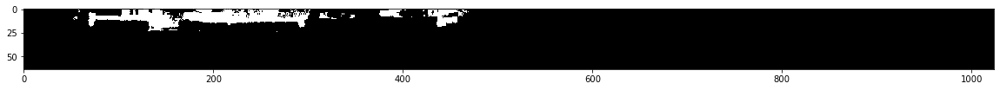

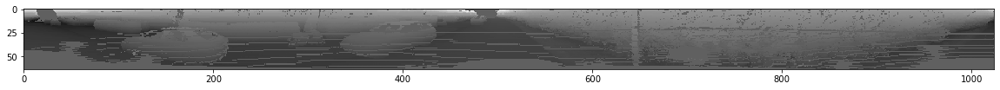

In [16]:
test_data = CustomKittiWithOrig("/home/polosatik/mnt/kitty/dataset/sequences/00/", mode="test") 

test_loader_basic = DataLoader(test_data, batch_size=1, shuffle=True)

test_loader(test_loader_basic)